<h1>Считать информацию с паспартов

Изначально много искал информации по уже готовым решениям в данной теме и все они используют технологию MRZ, Где находят нижнюю часть паспорта и OCR уже по ней и декодируют. В данном случае всего у парочки паспартов есть зона MRZ, так что предположил , что даже не стоит пробовать отдельные фотки по MRZ шифровать. 
<br></br>
Нашел две основные библиотеки по работе с русским OCR PyTesserach и easyocr. Провел предобработку данных, посмотрел как работает тессеракт с и без обработки изображений разными способами. Переворачивал картинку для чтения перевернутых цифр (серия и номер паспорта) и трансформировал координаты в формат нормальной ротации.
<br></br>
Далее попробовал различные API по СМ , где лучшим образом показал себя от майкрософта, поэтому решил далее использовать его.
<br></br>
Времени , к сожалению, на собственный алгоритм не хватило, так как уже долгое время нахожусь в сильном жаре, тяжко много времени было уделять заданию, поэтому как смог написал. Рад был бы подробнее обсудить код и логику


In [ ]:
pip install pytesseract

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 3.2 MB 11.9 MB/s 
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2


In [ ]:
#!sudo apt install tesseract-ocr

In [ ]:
!sudo apt-get install tesseract-ocr-rus

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following additional packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd tesseract-ocr-rus
0 upgraded, 4 newly installed, 0 to remove and 5 not upgraded.
Need to get 6,067 kB of archives.
After this operation, 19.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-eng all 4.00~git24-0e00fe6-1.2 [1,588 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr-osd all 4.00~git24-0e00fe6-1.2 [2,989 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic/universe amd64 tesseract-ocr amd64 4.00~git2288-10f4998a-2 [218 kB]
Get:4 http://archive.ubuntu.c

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from imutils.contours import sort_contours
import numpy as np
#import pytesseract
import imutils
import sys
import cv2
import re

In [ ]:
from google.colab.patches import cv2_imshow

Функция для отрисовки bbox'ов, один вариант для случая массива bounding box ,а другой случай на отрисовку еденичного бокса и лейбла

In [ ]:
def rect_n_label(img,bboxes,labels,t_shape=True):
  for i in range(len(bboxes)):
    try:
      cv2.rectangle(img, (int(bboxes[i][0]), int(bboxes[i][1])), 
                  (int(bboxes[i][2]), int(bboxes[i][3])), 
                  (255, 255, 255), 3)
      text_width = cv2.getTextSize(labels[i], cv2.FONT_HERSHEY_COMPLEX, 1, 2)[0][0]
      if t_shape:
        add_T_label(img,labels[i],bboxes[i])
      else:
        label_bg = [bboxes[i][0],bboxes[i][1],bboxes[i][0]+text_width//2,bboxes[i][1]-15]
        try:
            cv2.rectangle(img,(label_bg[0], label_bg[1]),(label_bg[2], label_bg[3]), (255, 255, 0), -1)
            cv2.putText(img, labels[i], (bboxes[i][0], bboxes[i][1]),cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1)
        except:
            print(i,'элемент выдал ошибку')
            print(labels[i],'-слово не может быть обработано')
    except:
        cv2.rectangle(img, (int(bboxes[0]), int(bboxes[1])), 
                  (int(bboxes[2]), int(bboxes[3])), 
                  (255, 255, 255), 3)
        text_width = cv2.getTextSize(labels, cv2.FONT_HERSHEY_COMPLEX, 1, 2)[0][0]
        if t_shape:
          add_T_label(img,labels,bboxes)
        else:
          label_bg = [bboxes[0],bboxes[1],bboxes[0]+text_width//2,bboxes[1]-15]
          try:
              cv2.rectangle(img,(label_bg[0], label_bg[1]),(label_bg[2], label_bg[3]), (255, 255, 0), -1)
              cv2.putText(img, labels (bboxes[0], bboxes[1]),cv2.FONT_HERSHEY_COMPLEX, 0.5, (0, 0, 0), 1)
          except:
              print(i,'элемент выдал ошибку')
              print(labels[i],'-слово не может быть обработано')

Функция для отображения label'ов в формате Т. Пригодилось для более корректного отображения элементов , которые напечатаны боком

In [ ]:
def add_T_label(img,
                label,
                bbox,
                draw_bg=True,
                text_bg_color=(255, 255, 255),
                text_color=(0, 0, 0)):
    text_width = cv2.getTextSize(label, cv2.FONT_HERSHEY_COMPLEX, 1, 2)[0][0]
    text_height = cv2.getTextSize(label, cv2.FONT_HERSHEY_COMPLEX, 1, 2)[0][1]

    x_center = (bbox[0] + bbox[2]) // 2
    y_top = bbox[1] - 10
    cv2.line(img, (x_center, bbox[1]), (x_center, y_top), text_bg_color, 2)

    y_bottom = y_top
    y_top = y_bottom - text_height - 5
    x_left = x_center - (text_width // 2) - 5
    x_right = x_center + (text_width // 2) + 5
    if draw_bg:
        cv2.rectangle(img, (x_left, y_top - 3), (x_right-5, y_bottom),
                      text_bg_color, -1)
    cv2.putText(img, label, (x_left+3, y_bottom-5),
                cv2.FONT_HERSHEY_COMPLEX, 0.8, text_color, 2)

    return img

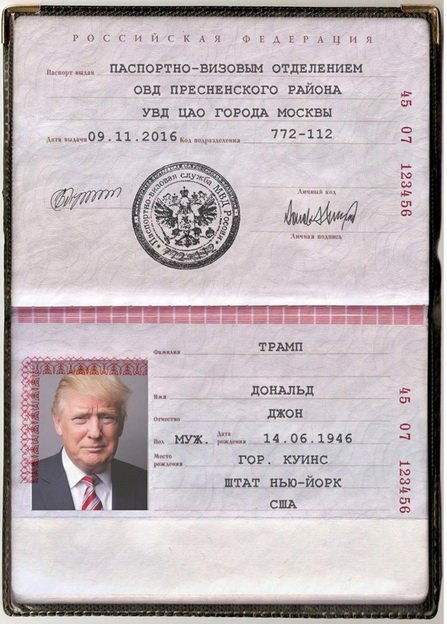

In [ ]:
image = cv2.imread('/content/drive/MyDrive/DataForOCR/0.jpeg')
cv2_imshow(image)

In [ ]:
textImage = pytesseract.image_to_string(image, lang="rus")
print(textImage)

осхийскуй ХЕлЕвИЯ

ОТДЕЛЕНИЕ УФМС РОССИИ
ПО ПСКОВСКОЙ ОБЛАСТИ

В ПЫТАЛОВСКОМ РАЙОНЕ
9.08. 01а 600-022

   

2-е зай”: рен

С лет з р
ми в инк

т 88

318 08Т

 

 

 

 

 

 

 

 

 

 

 

 

 
   

РОМАН

ЮРЬЕВИЧ
МУЖ. „.. 16.06.1995
рожлние _

 

= ай я
РМЕИ$МАКАКО\< < ВОМАМ< 7В9ЕУТЗ<<<<<<<<<<<<

5811808421859506169м<<<<<<<



Подгрузили фотографию и попробовали обработать ее с помощью специальной OCR библиотекии pytesserect, что не дало впечетляющих результатов без обработки изобрайжений

Вместо того, чтобы pytesseract'у подавать целое изображение, попробую использовать openCV встроенный детектор текста, чтобы он выдал bbox'ы текста и подавать уже кропы изображения для распознования. Использовал гайд из интернета по работе с данным детектором, понадобился гайд по формату изображения и декодинга детектора

In [ ]:
from imutils.object_detection import non_max_suppression
import numpy as np
#import pytesseract
import argparse
import cv2

In [ ]:
def decode_predictions(scores, geometry):
	# вытаскиваем кол-во строк и столбцов в scores , а также инициализация массивов для записи результатов, rects - координаты bbox, а confidences - соответствующее значение уверенности
	(numRows, numCols) = scores.shape[2:4]
	rects = []
	confidences = []
	# итерация по кол-ву строк
	for y in range(0, numRows):
		# вытаскиваем метрику уверенности,
		# вытаскиваем координаты bbox
		# а также вытаскиваем информацию о угле поворота
		scoresData = scores[0, 0, y]
		xData0 = geometry[0, 0, y]
		xData1 = geometry[0, 1, y]
		xData2 = geometry[0, 2, y]
		xData3 = geometry[0, 3, y]
		anglesData = geometry[0, 4, y]
		# итерация по кол-ву колонок
		for x in range(0, numCols):
			# фильтрация по нужной уверенности, подобрал 0.3 исходя из результатов scores
			if scoresData[x] < 0.3:
				continue
			#коэффициенты смещения т.к. итоговая карта фич будет в 4 раза меньше исходного изображения
			(offsetX, offsetY) = (x * 4.0, y * 4.0)
			#вычесление синуса и косинуса для поправки угла предсказания
			angle = anglesData[x]
			cos = np.cos(angle)
			sin = np.sin(angle)
			# вычисляем высоту и ширину
			h = xData0[x] + xData2[x]
			w = xData1[x] + xData3[x]
			# вычисляем финальные координаты исходя из поворота и смещения
			endX = int(offsetX + (cos * xData1[x]) + (sin * xData2[x]))
			endY = int(offsetY - (sin * xData1[x]) + (cos * xData2[x]))
			startX = int(endX - w)
			startY = int(endY - h)
			# добавляем в массивы координаты текста и соответсвующее значение уверенности
			rects.append((startX, startY, endX, endY))
			confidences.append(scoresData[x])
	return (rects, confidences)

Функция отвечает за форматирование геометрических данных выданных детектором в нужный нам формат координат для подачи кропов изображения на распознавание текста

In [ ]:
image = cv2.imread('/content/drive/My Drive/DataForOCR/3.jpeg')
orig = image.copy()
(origH, origW) = image.shape[:2]
#переформатирование в формат подходящий для детектора
(newW, newH) = (320, 320)
rW = origW / float(newW)
rH = origH / float(newH)
image = cv2.resize(image, (newW, newH))
(H, W) = image.shape[:2]

In [ ]:
# Слои предназначены для выдачи вероятности нахождения текста и его bbox, детектор openCV frozen_east_text_detection
layerNames = [
	"feature_fusion/Conv_7/Sigmoid",
	"feature_fusion/concat_3"]
net = cv2.dnn.readNet('/content/drive/My Drive/frozen_east_text_detection.pb')

In [ ]:
#blob = cv2.dnn.blobFromImage(image, 1.0, (W, H),(123.68, 116.78, 103.94), swapRB=True, crop=False)
#Форматирование данных в формат blob для детектора
blob = cv2.dnn.blobFromImage(image, 1.0, (W, H), swapRB=True, crop=False)
net.setInput(blob)
(scores, geometry) = net.forward(layerNames)

In [ ]:
(rects, confidences) = decode_predictions(scores, geometry)
boxes = non_max_suppression(np.array(rects), probs=confidences)

Получили  bbox'ы и вероятности , избавились от перехлестных менее вероятных, и теперь готовы для отправки на распознавание

In [ ]:
bboxes = []
labels = []
for (startX, startY, endX, endY) in boxes:
  # умеряем координаты bbox'ов в соответсвующем отношении 
  startX = int(startX * rW)
  startY = int(startY * rH)
  endX = int(endX * rW)
  endY = int(endY * rH)
  #высчитываем паддинг, показало, что с паддингом дает лучший результат
  dX = int((endX - startX) * 0.1)
  dY = int((endY - startY) * 0.1)
  startX = max(0, startX - dX)
  startY = max(0, startY - dY)
  endX = min(origW, endX + (dX * 2))
  endY = min(origH, endY + (dY * 2))

  roi = orig[startY:endY, startX:endX]

  
  config = ("-l rus --oem 1 --psm 7")
  #config = ("--oem 3 --psm 6 outputbase digits")
  text = pytesseract.image_to_string(roi, config=config)

  bboxes.append([startX, startY, endX, endY])
  labels.append(text)

In [ ]:
labels

['РОССИИ П\\\n\x0c',
 'ЛОМ }\n\x0c',
 'ДАЙМОНД\n\x0c',
 'ОТДЕЛО\n\x0c',
 'УФМС Е\n\x0c',
 'по\n\x0c',
 'ее:\n\x0c',
 'ДМИТРИЙ\n\x0c',
 'АЙОНЕ 1\n\x0c',
 '"САМАРСЬ\n\x0c',
 '| ОБЛАСТИ\n\x0c',
 'В\n\x0c',
 'АЛЬНОМ\n\x0c',
 '_ гов. ‹\n\x0c',
 '5.1986\n\x0c',
 '3 ЦЕНТРАЛЬ\n\x0c',
 '`тоРОдДА 1\n\x0c',
 'т\n\x0c',
 'ки <\n\x0c',
 '\x0c',
 '„08.\n\x0c',
 '= , р "\n\x0c',
 'не\n\x0c']

In [ ]:
rect_n_label(orig,bboxes,labels)

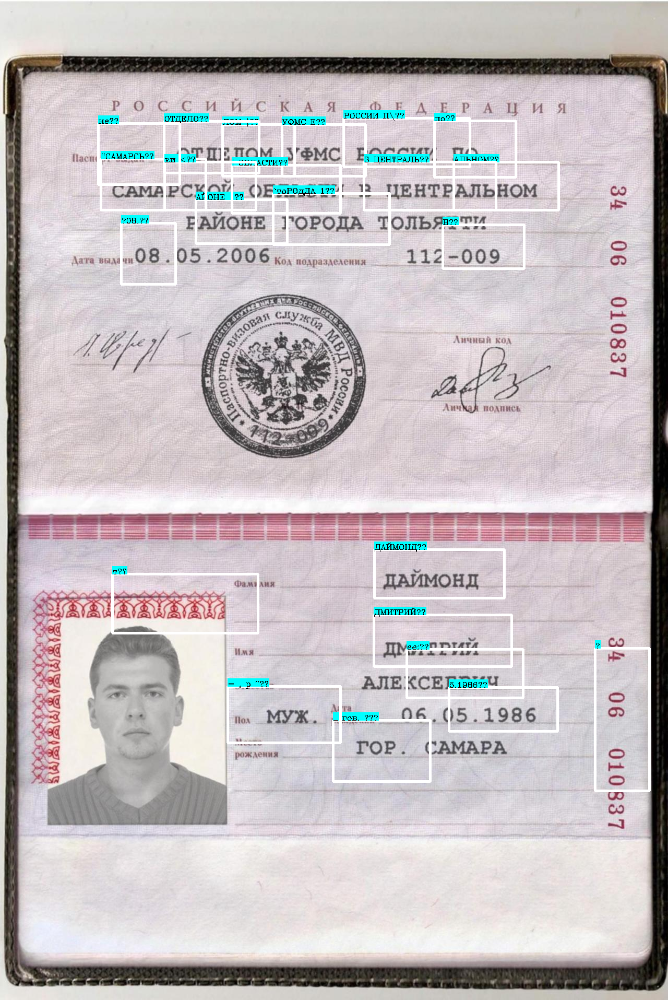

In [ ]:
cv2_imshow(orig)

Здесь также результаты совсем не приятные, детекция оставляет желать лучшего, а также само распознавание столкнулось с различными проблемами, среди них есть проблема с кодировкой, из-за чего и множество вопросительных знаков. Отсюда напрашивается вывод, что у pytesseract на русском есть проблемы и разные способы обработки изображений не дают существенных приростов к качеству

<h1>easyocr library

In [ ]:
pip install easyocr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.9 MB 14.8 MB/s 
     |████████████████████████████████| 604 kB 87.5 MB/s 
     |████████████████████████████████| 145 kB 85.1 MB/s 
     |████████████████████████████████| 47.6 MB 1.4 MB/s 
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.6.0.66
    Uninstalling opencv-python-headless-4.6.0.66:
      Successfully uninstalled opencv-python-headless-4.6.0.66


In [ ]:
import easyocr
from google.colab.patches import cv2_imshow
import cv2

In [ ]:
reader = easyocr.Reader(['ru'])

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.1% Complete

Нашел интересную библиотеку easyocr, где поддерживается множество языков, решил ее проверить тоже как справиться с изображениями паспортов

In [ ]:
def get_ocr(img_path,):
  result = reader.readtext(img_path)
  bboxes=[]
  labels=[]
  conf_score = []
  threshold = 0.3
  for i in range(len(result)):
    if result[i][2] > threshold:
      xmin = 10000
      ymin = 10000
      xmax = 0
      ymax = 0
      for j in range(len(result[i][0])):
        x = result[i][0][j][0]
        y = result[i][0][j][1]
        if x <= xmin and y <= ymin:
          xmin = x
          ymin = y
        elif x >= xmax and y >= ymax:
          xmax=x
          ymax=y
      bboxes.append([int(xmin), int(ymin), int(xmax), int(ymax)])
      labels.append(result[i][1])
      conf_score.append(result[i][2])
  return bboxes, labels

В функции get_ocr прогоняем через модель easyocr изображение, и записываем результат в переменную result, где у нас есть данных о уверенности модели, координаты 4ех точек и сам текст. По уверенности делаем фильтр в 0.3 исходя из наблюдений, меньше 0.3 обычно разный шум. Далее находим нижнюю левую точку и верхнюю правую, для того, чтобы работать с привычным форматом bbox и далее отобразить на самом изображении вместе с самим текстом

[414, 125, 398, 147]
[414, 125, 398, 147]
[414, 125, 398, 147]
[414, 125, 398, 147]
[416, 161, 398, 219]
[416, 161, 398, 219]
[416, 161, 398, 219]
[416, 161, 398, 219]
[412, 421, 396, 443]
[412, 421, 396, 443]
[412, 421, 396, 443]
[412, 421, 396, 443]
[414, 459, 396, 517]
[414, 459, 396, 517]
[414, 459, 396, 517]
[414, 459, 396, 517]


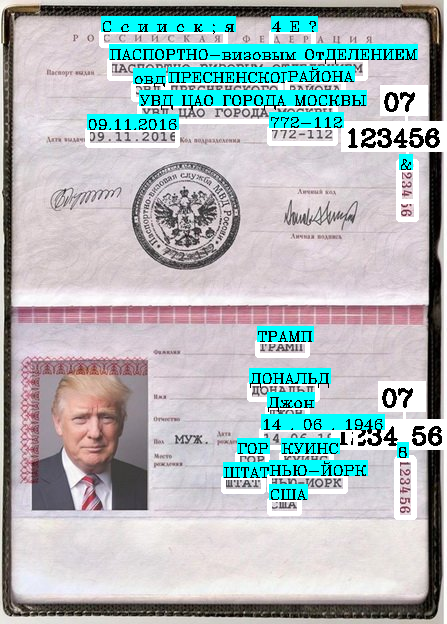

[528, 139, 508, 165]
[528, 139, 508, 165]
[528, 139, 508, 165]
[528, 139, 508, 165]
[528, 183, 508, 209]
[528, 183, 508, 209]
[528, 183, 508, 209]
[528, 183, 508, 209]
[526, 227, 506, 297]
[526, 227, 506, 297]
[526, 227, 506, 297]
[526, 227, 506, 297]
[520, 491, 500, 523]
[520, 491, 500, 523]
[520, 491, 500, 523]
[520, 491, 500, 523]
[520, 535, 500, 563]
[520, 535, 500, 563]
[520, 535, 500, 563]
[520, 535, 500, 563]
[520, 581, 500, 651]
[520, 581, 500, 651]
[520, 581, 500, 651]
[520, 581, 500, 651]


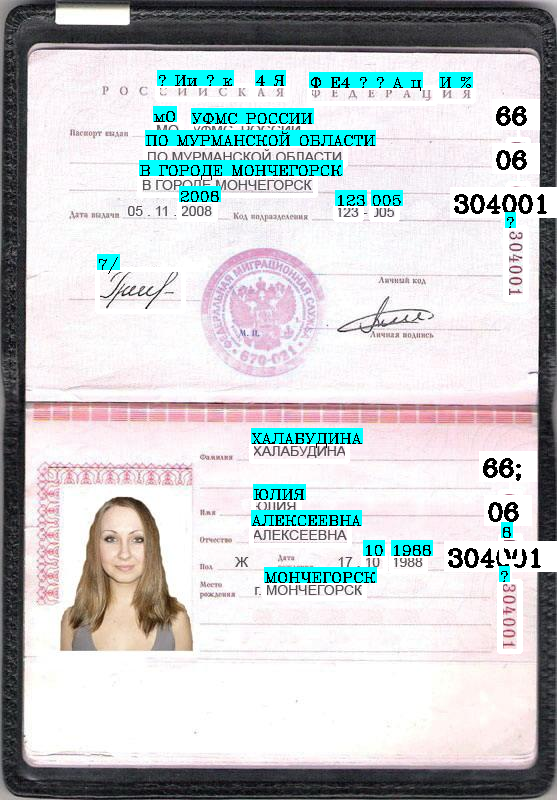

[518, 139, 498, 163]
[518, 139, 498, 163]
[518, 139, 498, 163]
[518, 139, 498, 163]
[518, 181, 498, 209]
[518, 181, 498, 209]
[518, 181, 498, 209]
[518, 181, 498, 209]
[521, 228, 497, 300]
[521, 228, 497, 300]
[521, 228, 497, 300]
[521, 228, 497, 300]
[516, 509, 496, 533]
[516, 509, 496, 533]
[516, 509, 496, 533]
[516, 509, 496, 533]
[516, 551, 498, 579]
[516, 551, 498, 579]
[516, 551, 498, 579]
[516, 551, 498, 579]
[519, 598, 495, 672]
[519, 598, 495, 672]
[519, 598, 495, 672]
[519, 598, 495, 672]
[504, 661, 384, 749]
[504, 661, 384, 749]
[504, 661, 384, 749]
[504, 661, 384, 749]


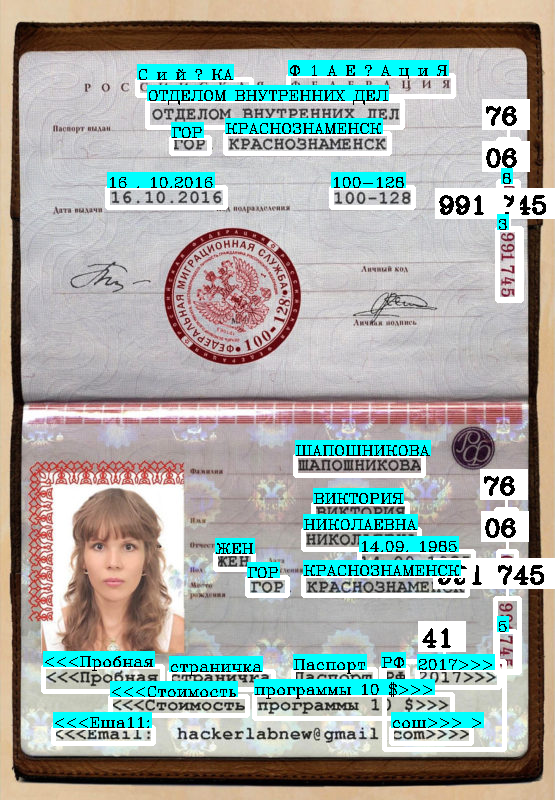

[1207, 349, 1163, 407]
[1207, 349, 1163, 407]
[1207, 349, 1163, 407]
[1207, 349, 1163, 407]
[1207, 453, 1165, 515]
[1207, 453, 1165, 515]
[1207, 453, 1165, 515]
[1207, 453, 1165, 515]
[1212, 559, 1161, 730]
[1212, 559, 1161, 730]
[1212, 559, 1161, 730]
[1212, 559, 1161, 730]
[1203, 1213, 1159, 1273]
[1203, 1213, 1159, 1273]
[1203, 1213, 1159, 1273]
[1203, 1213, 1159, 1273]
[1203, 1319, 1161, 1381]
[1203, 1319, 1161, 1381]
[1203, 1319, 1161, 1381]
[1203, 1319, 1161, 1381]
[1203, 1427, 1159, 1595]
[1203, 1427, 1159, 1595]
[1203, 1427, 1159, 1595]
[1203, 1427, 1159, 1595]


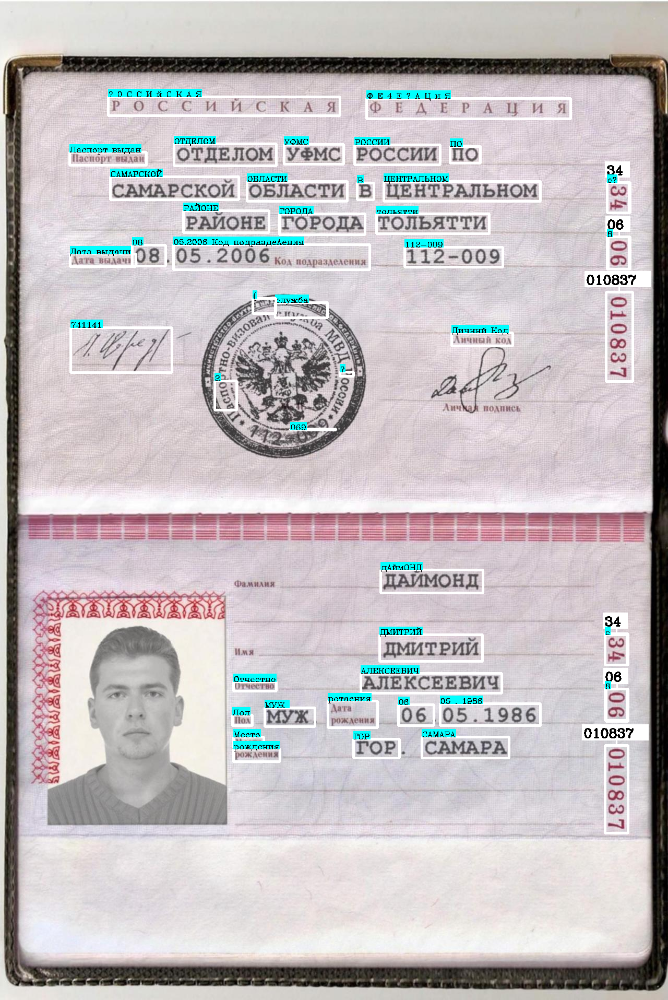

[507, 288, 481, 294]
[507, 288, 481, 294]
[507, 288, 481, 294]
[507, 288, 481, 294]


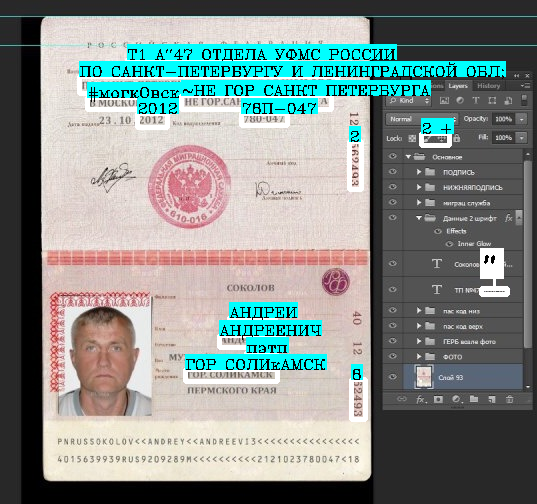

[726, 610, 696, 650]
[726, 610, 696, 650]
[726, 610, 696, 650]
[726, 610, 696, 650]
[728, 678, 700, 718]
[728, 678, 700, 718]
[728, 678, 700, 718]
[728, 678, 700, 718]
[732, 750, 700, 858]
[732, 750, 700, 858]
[732, 750, 700, 858]
[732, 750, 700, 858]
[704, 108, 674, 144]
[704, 108, 674, 144]
[704, 108, 674, 144]
[704, 108, 674, 144]
[706, 168, 680, 204]
[706, 168, 680, 204]
[706, 168, 680, 204]
[706, 168, 680, 204]
[713, 230, 677, 335]
[713, 230, 677, 335]
[713, 230, 677, 335]
[713, 230, 677, 335]
[717, 888, 462, 966]
[717, 888, 462, 966]
[717, 888, 462, 966]
[717, 888, 462, 966]


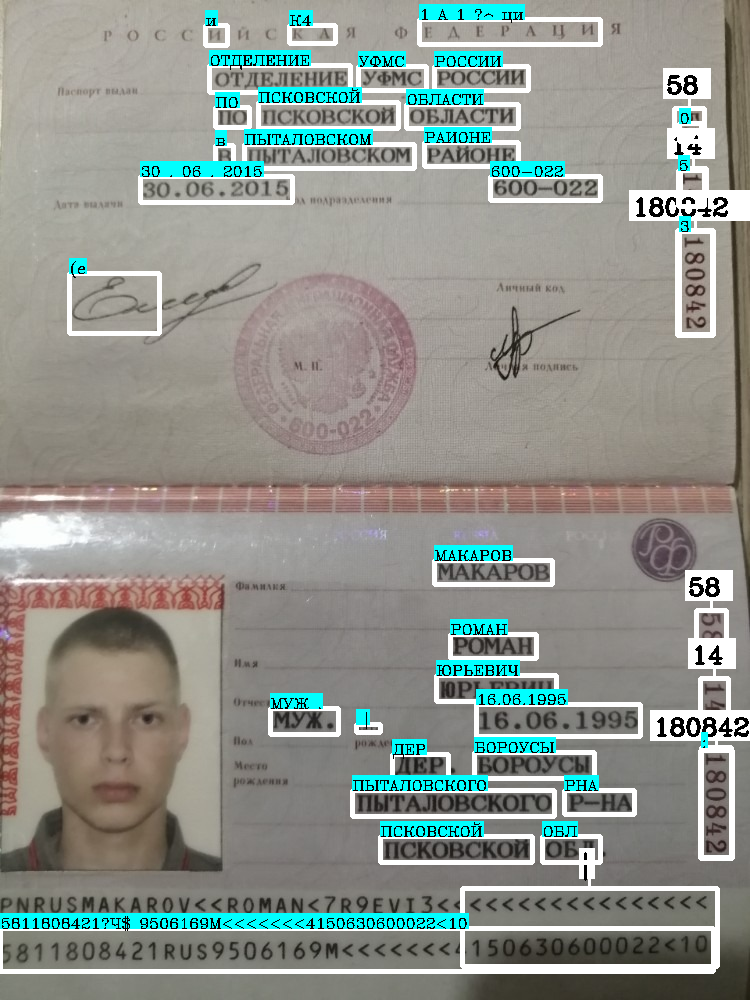

[354, 135, 338, 185]
[354, 135, 338, 185]
[354, 135, 338, 185]
[354, 135, 338, 185]


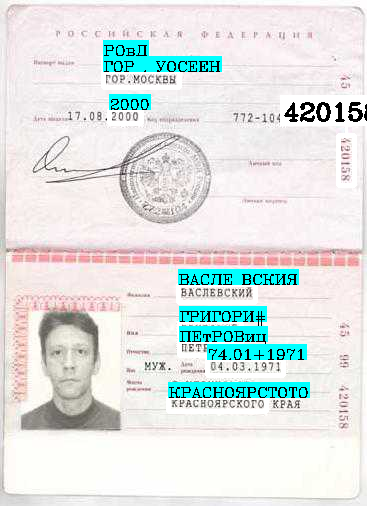

[928, 167, 892, 213]
[928, 167, 892, 213]
[928, 167, 892, 213]
[928, 167, 892, 213]
[930, 253, 894, 303]
[930, 253, 894, 303]
[930, 253, 894, 303]
[930, 253, 894, 303]
[935, 340, 895, 477]
[935, 340, 895, 477]
[935, 340, 895, 477]
[935, 340, 895, 477]
[937, 856, 905, 900]
[937, 856, 905, 900]
[937, 856, 905, 900]
[937, 856, 905, 900]
[937, 942, 905, 990]
[937, 942, 905, 990]
[937, 942, 905, 990]
[937, 942, 905, 990]
[940, 1029, 904, 1161]
[940, 1029, 904, 1161]
[940, 1029, 904, 1161]
[940, 1029, 904, 1161]


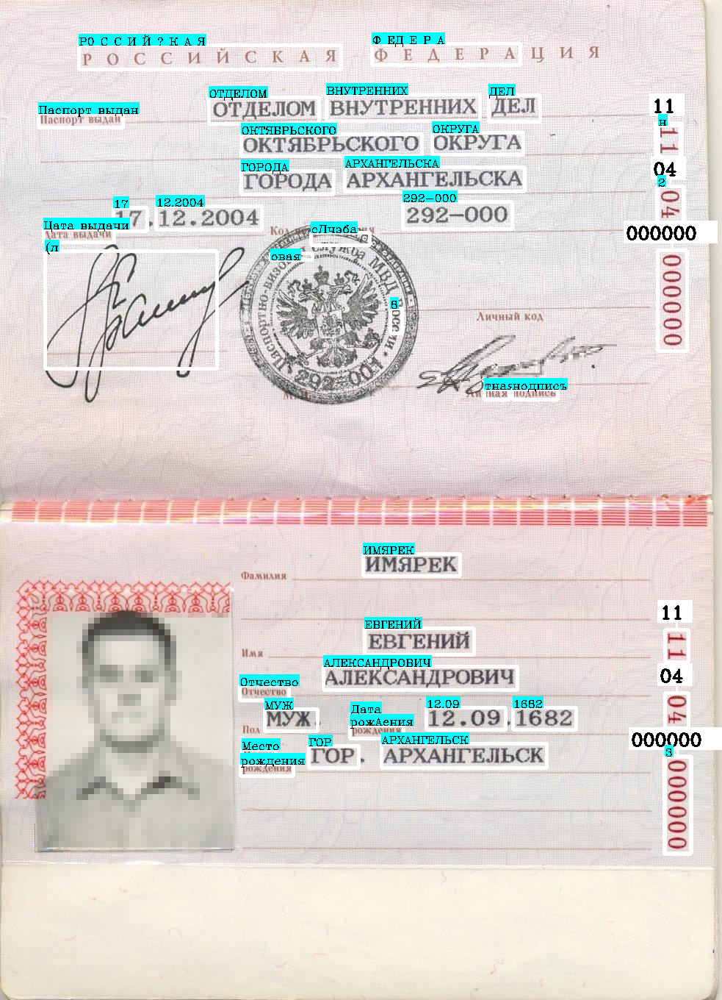

[1165, 125, 1145, 195]
[1165, 125, 1145, 195]
[1165, 125, 1145, 195]
[1165, 125, 1145, 195]
[1165, 215, 1145, 241]
[1165, 215, 1145, 241]
[1165, 215, 1145, 241]
[1165, 215, 1145, 241]
[1165, 257, 1145, 285]
[1165, 257, 1145, 285]
[1165, 257, 1145, 285]
[1165, 257, 1145, 285]


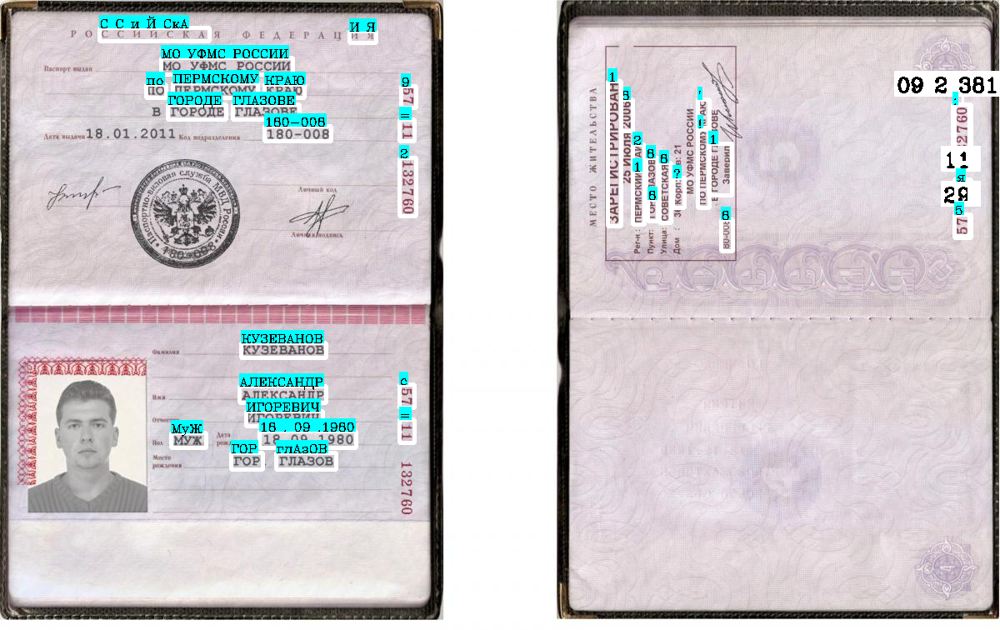

[1180, 477, 1138, 533]
[1180, 477, 1138, 533]
[1180, 477, 1138, 533]
[1180, 477, 1138, 533]
[1184, 579, 1142, 635]
[1184, 579, 1142, 635]
[1184, 579, 1142, 635]
[1184, 579, 1142, 635]
[1188, 681, 1138, 848]
[1188, 681, 1138, 848]
[1188, 681, 1138, 848]
[1188, 681, 1138, 848]
[1170, 1249, 1128, 1309]
[1170, 1249, 1128, 1309]
[1170, 1249, 1128, 1309]
[1170, 1249, 1128, 1309]
[1176, 1353, 1134, 1407]
[1176, 1353, 1134, 1407]
[1176, 1353, 1134, 1407]
[1176, 1353, 1134, 1407]
[1196, 1448, 1133, 1620]
[1196, 1448, 1133, 1620]
[1196, 1448, 1133, 1620]
[1196, 1448, 1133, 1620]
[1107, 505, 796, 550]
[1107, 505, 796, 550]
[1107, 505, 796, 550]
[1107, 505, 796, 550]


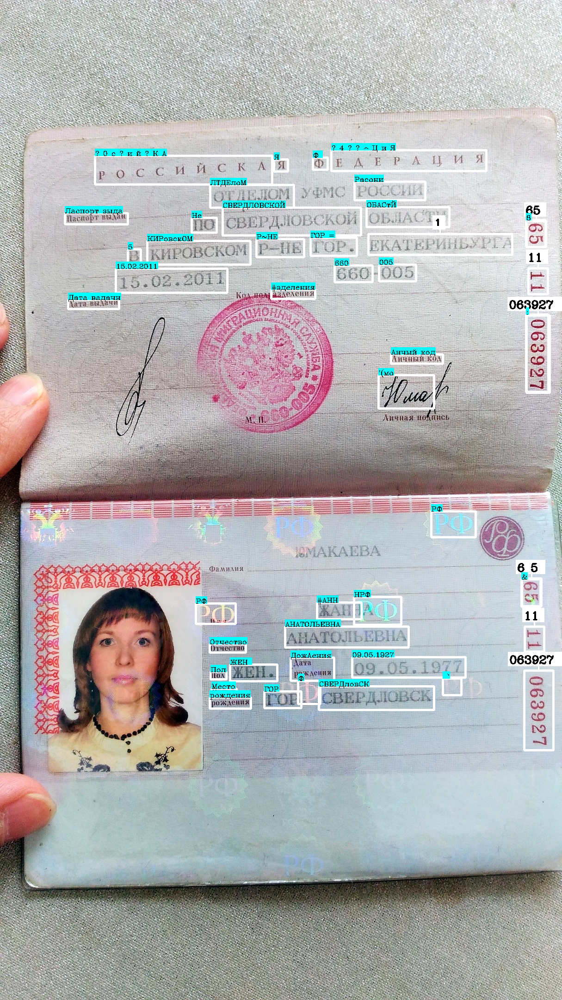

In [ ]:
for i in range(10):
  if i != 4:
    img = cv2.imread(f'/content/drive/My Drive/DataForOCR/{i}.jpeg')
  else:
    img = cv2.imread('/content/drive/My Drive/DataForOCR/4.png')
  bboxes, labels = get_ocr(img)
  bboxes_r, labels_r = get_ocr(img)
  for j in range(len(bboxes_r)):
    if (bboxes_r[j][1]) > (img.shape[1])-((img.shape[1]*7)//8):
      continue
    bboxes_r[j][0],bboxes_r[j][1],bboxes_r[j][2],bboxes_r[j][3] = img.shape[1] - bboxes_r[j][1],bboxes_r[j][0],img.shape[1] - bboxes_r[j][3],bboxes_r[j][2]
    rect_n_label(img,bboxes_r[j],labels_r[j],t_shape=True)
  rect_n_label(img,bboxes,labels,t_shape=False)
  cv2.imwrite(f'lib_ocr_{i}_v2.jpeg', img)
  cv2_imshow(img)

Отрисовка и сохранение изображений после работы детектора и распознования текста

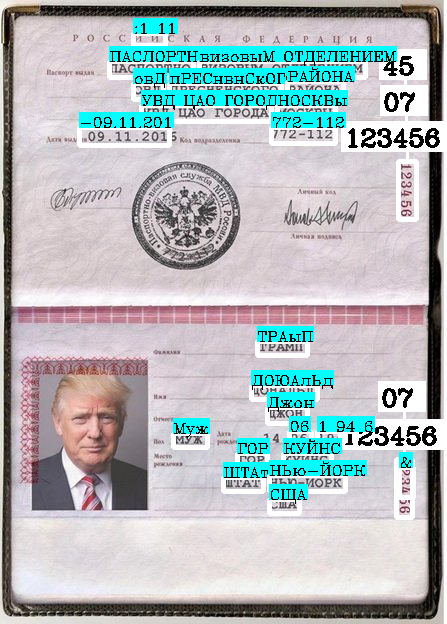

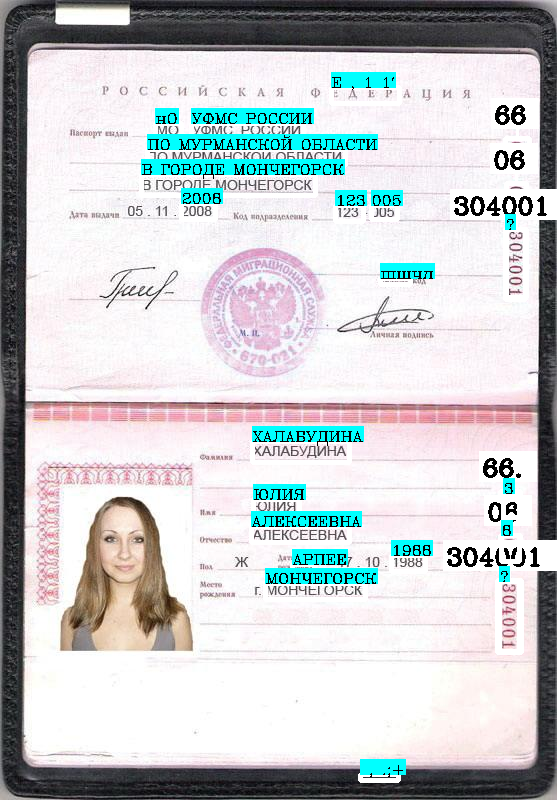

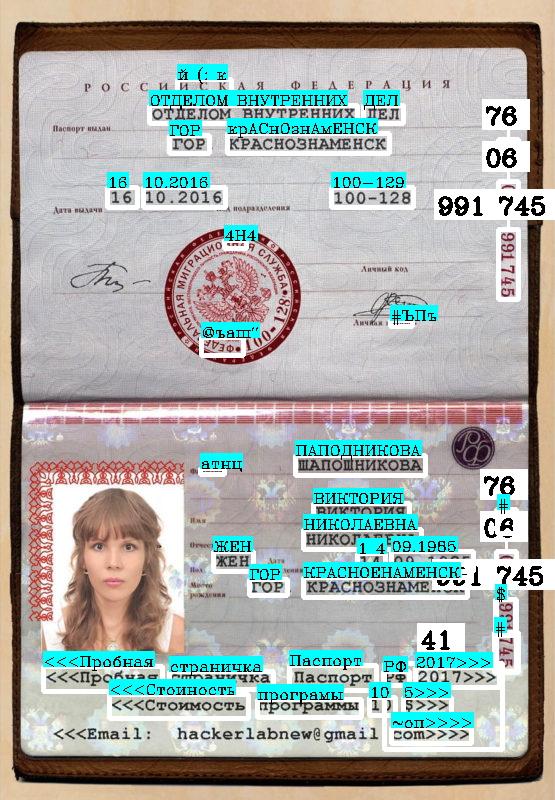

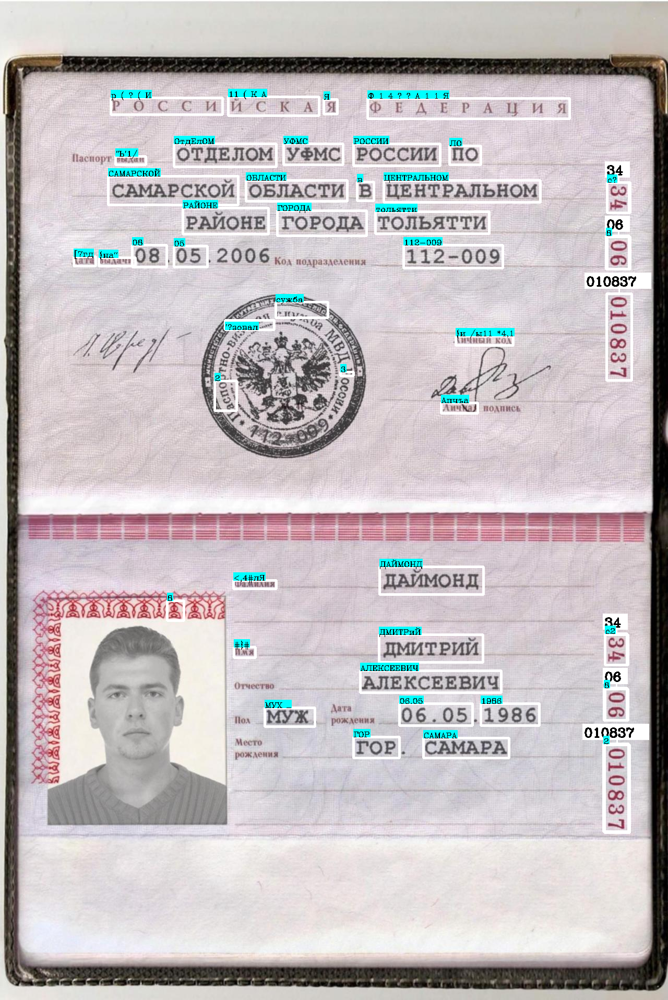

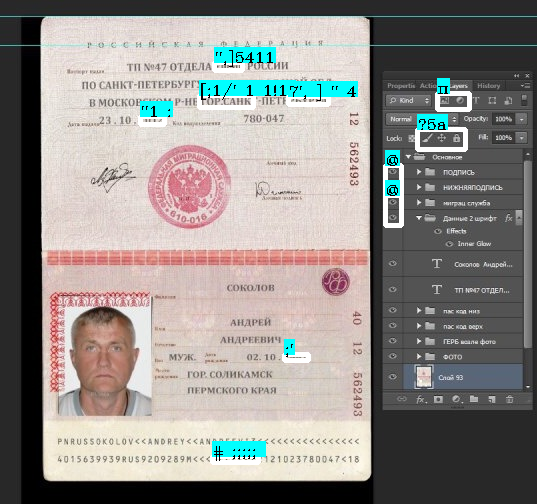

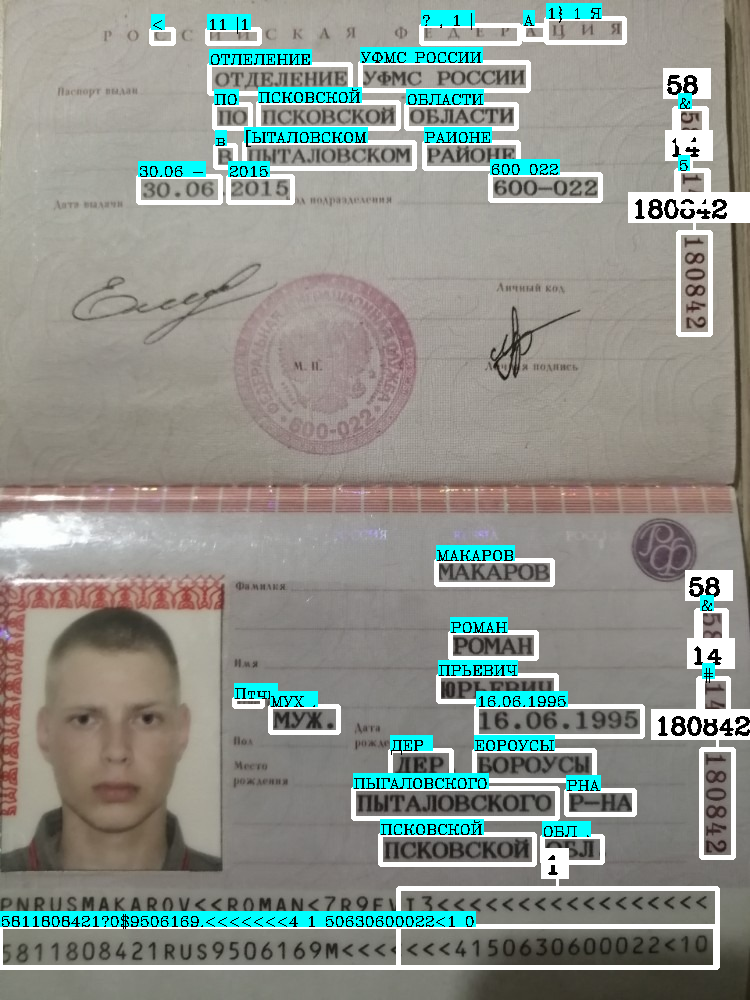

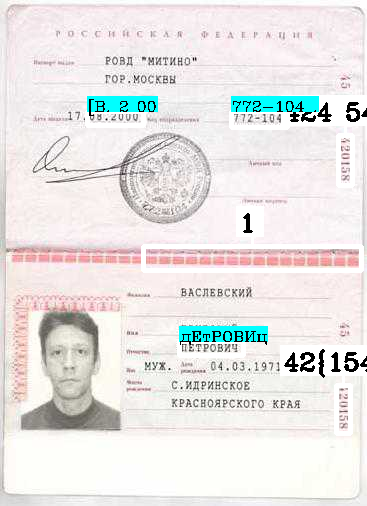

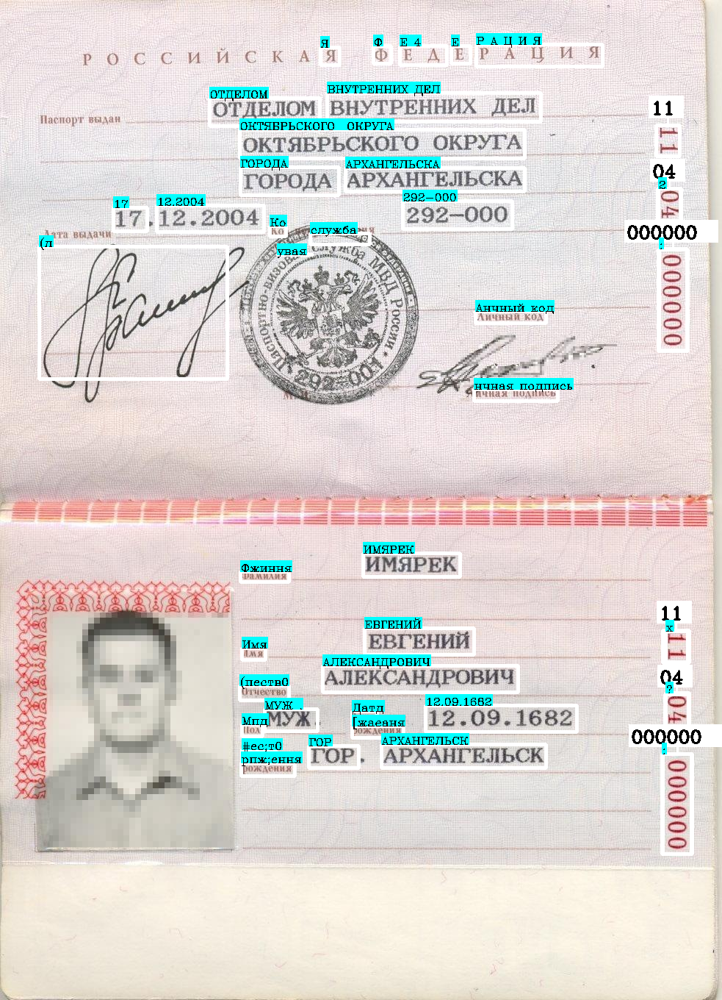

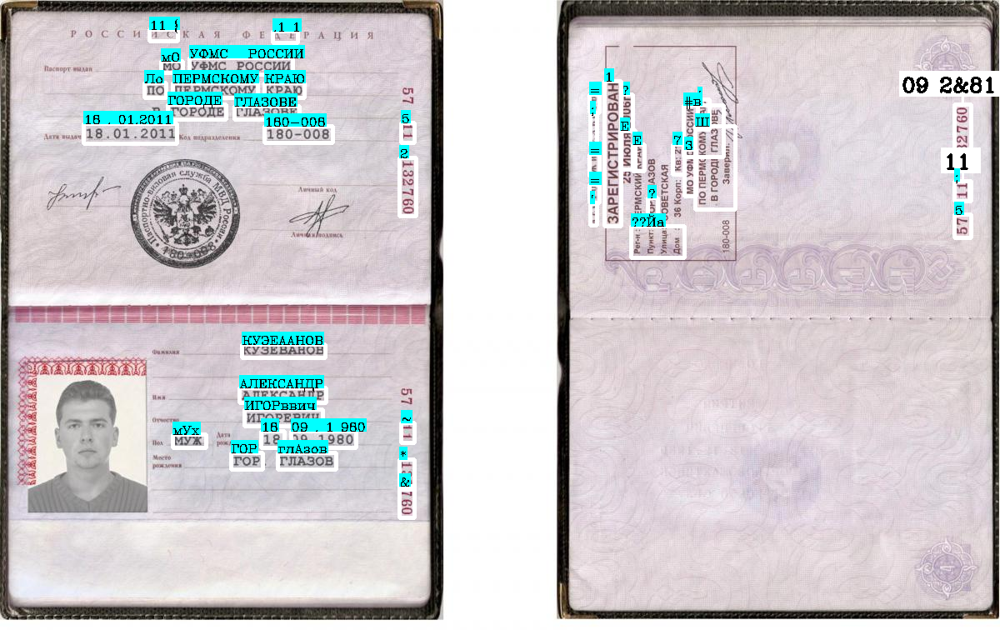

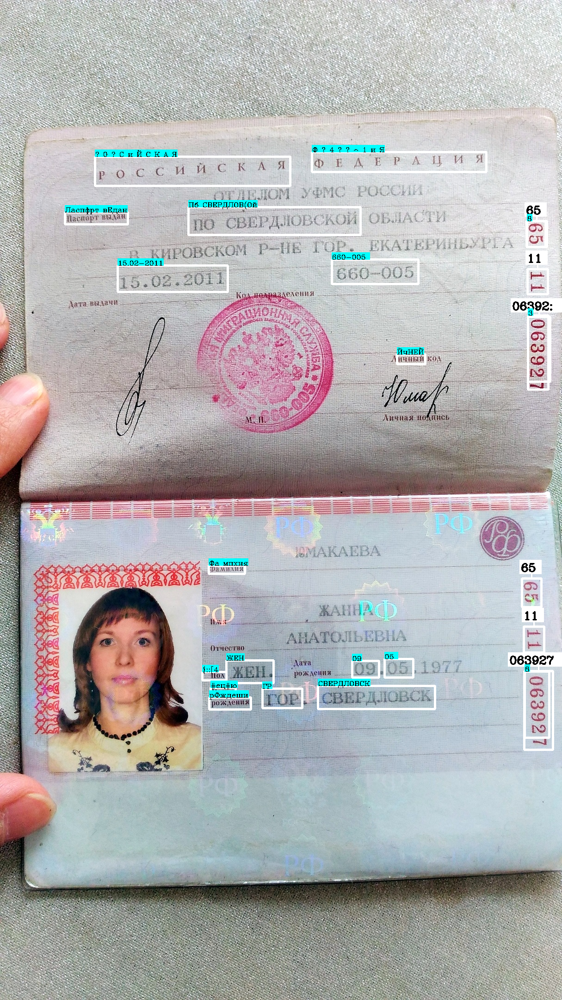

In [ ]:
for i in range(10):
  if i != 4:
    img = cv2.imread(f'/content/drive/My Drive/DataForOCR/{i}.jpeg')
  else:
    img = cv2.imread('/content/drive/My Drive/DataForOCR/4.png')

  img_r = cv2.imread(f'/content/drive/My Drive/DataForOCR/rotated/{i}.jpeg')
  img_show=img.copy()

    #перевод в чб изображения в норм ориентации
  img=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
  se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
  bg=cv2.morphologyEx(img, cv2.MORPH_DILATE, se)
  out_gray=cv2.divide(img, bg, scale=255)
  out_binary=cv2.threshold(out_gray, 0, 255, cv2.THRESH_OTSU )[1]

  #перевод в чб изображения повернутого на 90 градусов влево
  img_r=cv2.cvtColor(img_r,cv2.COLOR_BGR2GRAY)
  se_r=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
  bg_r=cv2.morphologyEx(img_r, cv2.MORPH_DILATE, se_r)
  out_gray_r=cv2.divide(img_r, bg_r, scale=255)
  out_binary_r=cv2.threshold(out_gray_r, 0, 255, cv2.THRESH_OTSU )[1]

  bboxes, labels = get_ocr(out_binary)
  bboxes_r, labels_r = get_ocr(out_binary_r)
  
  for j in range(len(bboxes_r)):
    if (bboxes_r[j][1]) > (img.shape[1])-((img.shape[1]*7)//8):
      continue
    bboxes_r[j][0],bboxes_r[j][1],bboxes_r[j][2],bboxes_r[j][3] = img.shape[1] - bboxes_r[j][1],bboxes_r[j][0],img.shape[1] - bboxes_r[j][3],bboxes_r[j][2]
    rect_n_label(img_show,bboxes_r[j],labels_r[j],t_shape=True)
  rect_n_label(img_show,bboxes,labels,t_shape=False)
  cv2.imwrite(f'lib_ocr_{i}_prep.jpeg', img_show)
  cv2_imshow(img_show)

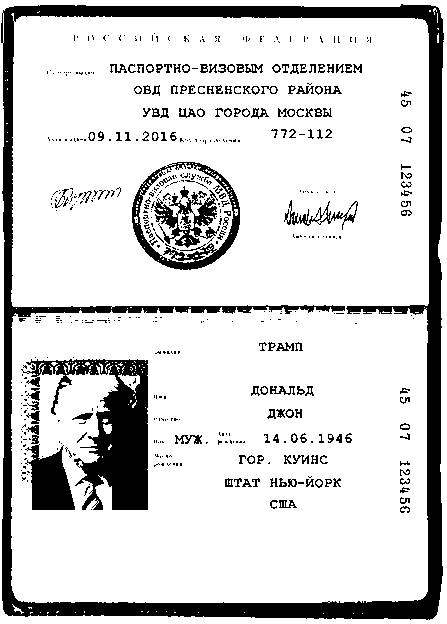

True

In [ ]:
image = cv2.imread('/content/drive/My Drive/DataForOCR/0.jpeg')
img=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
out_binary=cv2.threshold(img, 220, 255, cv2.THRESH_OTSU )[1] 

cv2_imshow(out_binary)  
cv2.imwrite('binary.png',out_binary)

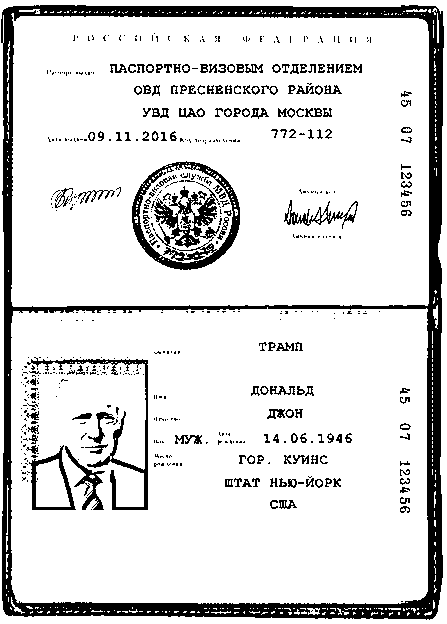

True

In [ ]:
image = cv2.imread('/content/drive/My Drive/DataForOCR/0.jpeg')
image=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
bg=cv2.morphologyEx(image, cv2.MORPH_DILATE, se)
out_gray=cv2.divide(image, bg, scale=255)
out_binary=cv2.threshold(out_gray, 0, 255, cv2.THRESH_OTSU )[1] 

cv2_imshow(out_binary)  
cv2.imwrite('binary.png',out_binary)

<h1>API


microsoft computer vision API

In [ ]:
import requests
import json

In [ ]:
def ocr_api(img_url,img):
  url = "https://microsoft-computer-vision3.p.rapidapi.com/ocr"

  querystring = {"detectOrientation":"false","language":"ru"}

  payload = {"url": img_url}
  headers = {
    "content-type": "application/json",
    "X-RapidAPI-Key": "4914a0deedmsh076eb2fffcc9cbfp1091dfjsn4ca5ce3d3eb0",
    "X-RapidAPI-Host": "microsoft-computer-vision3.p.rapidapi.com"
  }

  response = requests.request("POST", url, json=payload, headers=headers, params=querystring)

  #ответ от API конвертируем в JSON из стринга, и находим ответы по каждому слову и координаты, которые записываем в списки
  json_out = json.loads(response.text)
  bboxes=[]
  labels=[]
  #print(json_out)
  for k in range(len(json_out['regions'])):
    for i in range(len(json_out['regions'][k]['lines'])):
      for j in range(len(json_out['regions'][k]['lines'][i]['words'])):
        bboxes.append(list(map(int, json_out['regions'][k]['lines'][i]['words'][j]['boundingBox'].split(","))))
        labels.append(json_out['regions'][k]['lines'][i]['words'][j]['text'])
  for i in range(len(bboxes)):
    #формат данных в нужный(xmin ymin, xmax ymax)
    bboxes[i][2] = bboxes[i][0] + bboxes[i][2]
    bboxes[i][3] = bboxes[i][1] + bboxes[i][3]
  return bboxes, labels

In [ ]:
'''img_url_n_path = {'0.jpeg':['https://i.postimg.cc/MGvrjcbH/0.jpg','https://i.postimg.cc/J06Xswbx/0.jpg'],
                  '1.jpeg':['https://i.postimg.cc/L5ByMjRC/1.jpg','https://i.postimg.cc/fbDk9CDW/1.jpg'],
                  '2.jpeg':['https://i.postimg.cc/c1QkYGYR/2.jpg','https://i.postimg.cc/zBfBdfy9/2.jpg'],
                  '3.jpeg':['https://i.postimg.cc/BnwmsS90/3.jpg','https://i.postimg.cc/T3X3z0yj/3.jpg'],
                  '4.png':['https://i.postimg.cc/wTtzTGR8/4.png','https://i.postimg.cc/nVs6fQQ0/4.jpg'],
                  '5.jpeg':['https://i.postimg.cc/gksMSygr/5.jpg','https://i.postimg.cc/8cJCSnB4/5.jpg'],
                  '6.jpeg':['https://i.postimg.cc/zv1dMxmH/6.jpg','https://i.postimg.cc/ZqHnFN58/6.jpg'],
                  '7.jpeg':['https://i.postimg.cc/Z5qw19QH/7.jpg','https://i.postimg.cc/wTNB4ZBT/7.jpg'],
                  '8.jpeg':['https://i.postimg.cc/9FC8Ygtv/8.jpg','https://i.postimg.cc/B6wvRGDt/8.jpg'],
                  '9.jpeg':['https://i.postimg.cc/KYkJ86xg/9.jpg','https://i.postimg.cc/kgFgqS80/9.jpg']}'''

In [ ]:
img_url_n_path = {'0.jpeg':['https://downloader.disk.yandex.ru/preview/5824071cd2417bc1f9f08776f8eb13f0817427688d17b72393f6b7a319cd2e54/637cc944/fKqInKw3d7bLFOeFnMGnhGXP3Y8dU1txKA6yiwZniWjjNFq2rskYeXydtWv3crkyct4sU8txdP8p-XvMlueMlg6mb0oCHIeQDfXXc-8nVYmr8npumZHI4midPdWhecNq?uid=0&filename=0.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/J06Xswbx/0.jpg'],
                  '1.jpeg':['https://downloader.disk.yandex.ru/preview/4f96eaa76ff25d5a426c40a605c8fce0576951dd04f00d0e54eaf3f697a13006/637cc944/NQfOfsSBBpsT9ohhq3s6GfgSyK7OgwO0kBzOgEDLs4YLb4QLo7eWqPzvnEqQ8ti3POhLomvoBJqDeeTdzU4dMQ%3D%3D?uid=0&filename=1.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/fbDk9CDW/1.jpg'],
                  '2.jpeg':['https://downloader.disk.yandex.ru/preview/b44d07ebe71d45c40d935a83b9f0c8b5fa3584378c869383fd88bc36940b7f70/637cc944/jNeyAIM5I3AkkIqJH_ve5kAvJWyQ11nTVdG3AmBjqESVXyOVMHgOjHqKSKmUrRaqPkMqiZaORY-AeMpgWik_Vg%3D%3D?uid=0&filename=2.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/zBfBdfy9/2.jpg'],
                  '3.jpeg':['https://downloader.disk.yandex.ru/preview/6abe6833fa31f0a293bc6e5fd2baee6ff09d977d441757e4675d338f52bdb7c7/637cc944/kXSt2oO2zwZqTQvL-zA5n1QLrQbgWI9AJ_xomOYLR-ROO5sib18b9ITyMBPIWYW7ZgWDQa4EoANhKmftKg6gYw%3D%3D?uid=0&filename=3.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/T3X3z0yj/3.jpg'],
                  '4.png':['https://downloader.disk.yandex.ru/preview/53ab2000e458315dad82fc3e96dbbf46cced5a95b98d049eda81ba8ea27afc87/637cc944/-Djvje-MNwpGJ1sFoy4g8LFx0TAn5S9p6jh-fXgmn9nuBIHun80EAmpogFQHa_sVlGM-l6L_lcUoMvc9D4BfnA%3D%3D?uid=0&filename=4.png&disposition=inline&hash=&limit=0&content_type=image%2Fpng&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/nVs6fQQ0/4.jpg'],
                  '5.jpeg':['https://downloader.disk.yandex.ru/preview/3f0315994209c0456bbc88e7d194dca4eb24880d0cea8b2466f7a362a6be3e87/637cc944/WsPwXIy_DDVBdqt3pFlRXf9hdOf3LjK6-OME544V7xt5__PHice3d0nMO30_eARRR50ma4Z2U-ANKXy3Ms-7wg%3D%3D?uid=0&filename=5.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/8cJCSnB4/5.jpg'],
                  '6.jpeg':['https://downloader.disk.yandex.ru/preview/c693acb25dff11fbaede5d1c4472ff18b76b0d4525c60225703d846df39b9ab3/637cc944/xa0HMsNHNP9MTo6OiVCC_mKbim8yFSoNvDg8PqLfCbJSj4KOD1HJ3WxpOf7E9a4B6ygrc_yj1oae2oabYn7JYw%3D%3D?uid=0&filename=6.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/ZqHnFN58/6.jpg'],
                  '7.jpeg':['https://downloader.disk.yandex.ru/preview/017ccc63eca321172e53d8edad37d93c4a5f03e068d1bcb8f12bc1de974b9889/637cc944/XXfK4ZrM48i6gUsa05wTR5jvUsW32ZQK3xUL8DUYC1llt3jKac8Hl4Tfqhs2ek7MX9VGfy1ecwaQOYlS3sixBQ%3D%3D?uid=0&filename=7.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/wTNB4ZBT/7.jpg'],
                  '8.jpeg':['https://downloader.disk.yandex.ru/preview/4e9fcf5d8ca4cab9a7bd59f962526bc6cc2fd042f4ceece45d09dd5fbc6c2ad7/637cc944/sIMACbd-Zn9Gv9lBgQ8brmnnSIQ1ivvuMFJcaZbVxa4fMAAZQQgvHsppwAykH7ps157-DpfRYcICe8jKyyeDvw%3D%3D?uid=0&filename=8.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/B6wvRGDt/8.jpg'],
                  '9.jpeg':['https://downloader.disk.yandex.ru/preview/ed882f4edbb6522bc9b8d42632ad45ba48a04f48b90b9124261eed93dd42f35a/637cc944/mDBT-68ygZLdqpjF8N9REXSWtUE7XDXXqBXZPavG7mev4xEDrBmJUSWEyR462d6t-U3ylLpJUBu_COSYl4P0vw%3D%3D?uid=0&filename=9.jpeg&disposition=inline&hash=&limit=0&content_type=image%2Fjpeg&owner_uid=0&tknv=v2&size=2880x1340','https://i.postimg.cc/kgFgqS80/9.jpg']}
                  

[412, 91, 401, 107]
[412, 91, 401, 107]
[412, 91, 401, 107]
[412, 91, 401, 107]
[412, 127, 401, 143]
[412, 127, 401, 143]
[412, 127, 401, 143]
[412, 127, 401, 143]
[412, 164, 401, 216]
[412, 164, 401, 216]
[412, 164, 401, 216]
[412, 164, 401, 216]
[411, 423, 399, 440]
[411, 423, 399, 440]
[411, 423, 399, 440]
[411, 423, 399, 440]
[411, 460, 399, 513]
[411, 460, 399, 513]
[411, 460, 399, 513]
[411, 460, 399, 513]


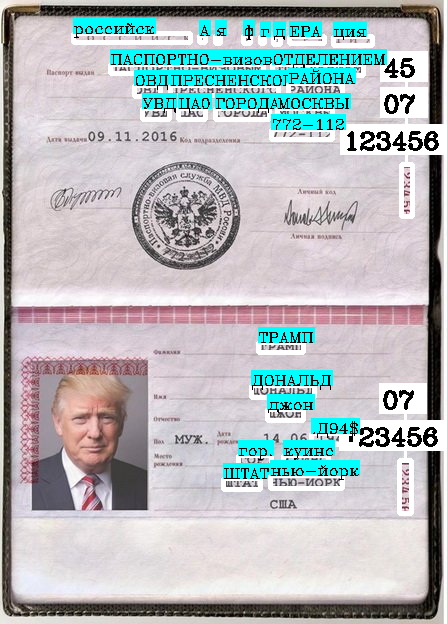

[519, 181, 505, 201]
[519, 181, 505, 201]
[519, 181, 505, 201]
[519, 181, 505, 201]
[521, 226, 505, 291]
[521, 226, 505, 291]
[521, 226, 505, 291]
[521, 226, 505, 291]
[519, 489, 504, 514]
[519, 489, 504, 514]
[519, 489, 504, 514]
[519, 489, 504, 514]
[521, 579, 506, 644]
[521, 579, 506, 644]
[521, 579, 506, 644]
[521, 579, 506, 644]


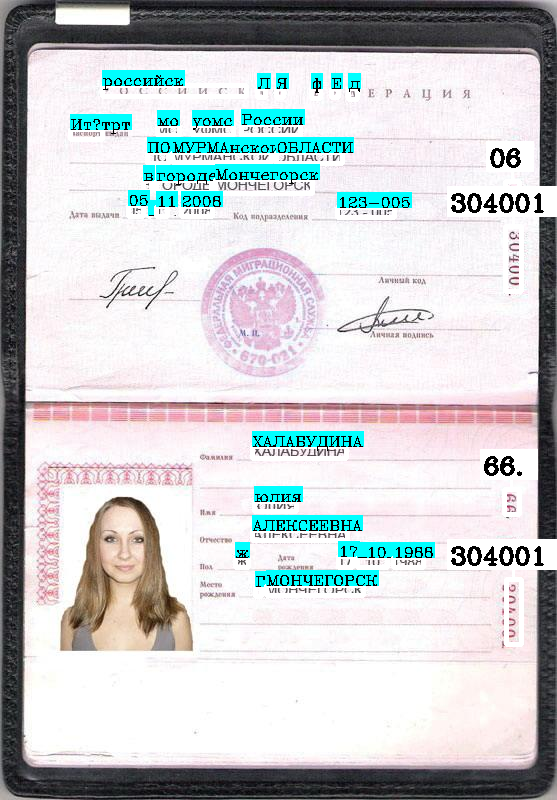

[515, 141, 501, 161]
[515, 141, 501, 161]
[515, 141, 501, 161]
[515, 141, 501, 161]
[515, 185, 501, 206]
[515, 185, 501, 206]
[515, 185, 501, 206]
[515, 185, 501, 206]
[515, 233, 501, 297]
[515, 233, 501, 297]
[515, 233, 501, 297]
[515, 233, 501, 297]
[513, 512, 499, 531]
[513, 512, 499, 531]
[513, 512, 499, 531]
[513, 512, 499, 531]
[513, 555, 499, 576]
[513, 555, 499, 576]
[513, 555, 499, 576]
[513, 555, 499, 576]
[513, 603, 498, 668]
[513, 603, 498, 668]
[513, 603, 498, 668]
[513, 603, 498, 668]
[449, 700, 438, 710]
[449, 700, 438, 710]
[449, 700, 438, 710]
[449, 700, 438, 710]
[447, 729, 437, 739]
[447, 729, 437, 739]
[447, 729, 437, 739]
[447, 729, 437, 739]


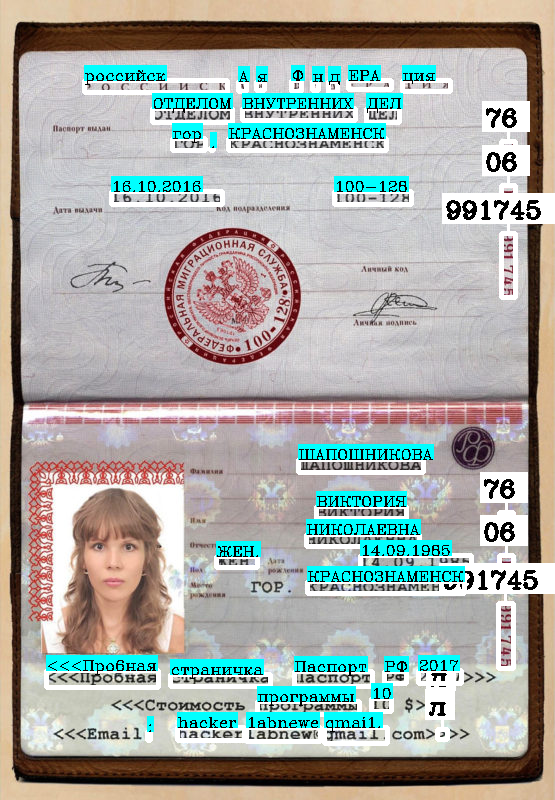

[807, 222, 787, 252]
[807, 222, 787, 252]
[807, 222, 787, 252]
[807, 222, 787, 252]
[807, 288, 786, 318]
[807, 288, 786, 318]
[807, 288, 786, 318]
[807, 288, 786, 318]
[807, 355, 786, 452]
[807, 355, 786, 452]
[807, 355, 786, 452]
[807, 355, 786, 452]
[804, 763, 784, 792]
[804, 763, 784, 792]
[804, 763, 784, 792]
[804, 763, 784, 792]
[804, 829, 784, 859]
[804, 829, 784, 859]
[804, 829, 784, 859]
[804, 829, 784, 859]
[804, 896, 784, 992]
[804, 896, 784, 992]
[804, 896, 784, 992]
[804, 896, 784, 992]


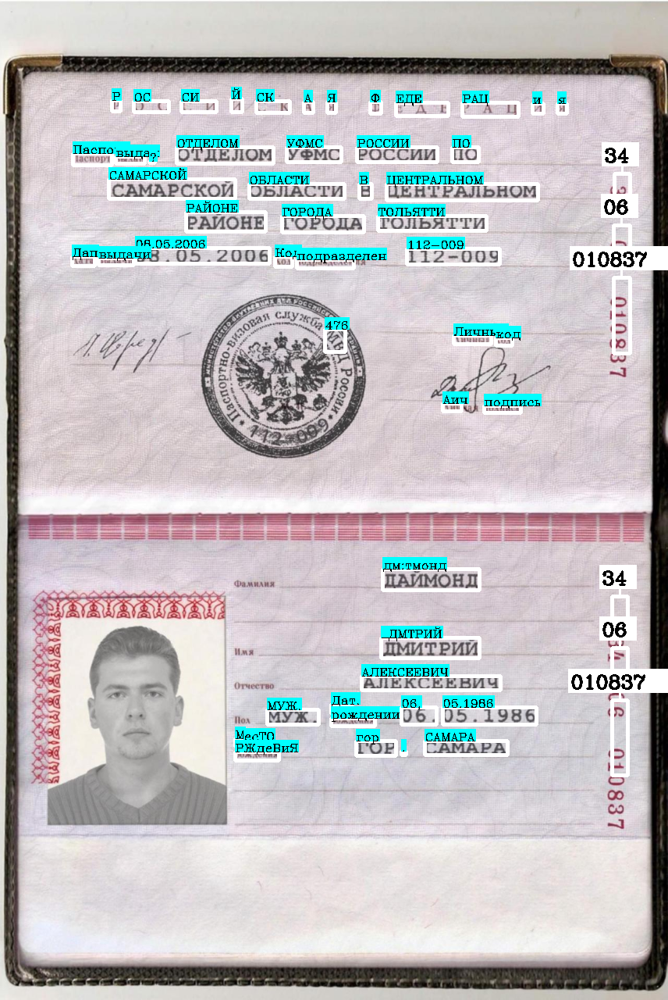

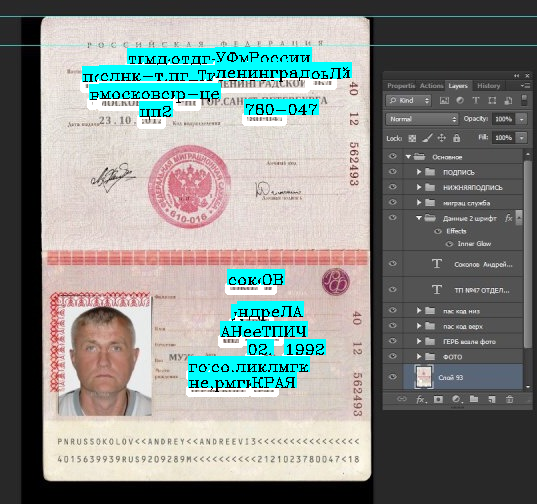

[726, 683, 704, 714]
[726, 683, 704, 714]
[726, 683, 704, 714]
[726, 683, 704, 714]
[700, 112, 680, 139]
[700, 112, 680, 139]
[700, 112, 680, 139]
[700, 112, 680, 139]
[703, 174, 682, 201]
[703, 174, 682, 201]
[703, 174, 682, 201]
[703, 174, 682, 201]
[723, 613, 701, 644]
[723, 613, 701, 644]
[723, 613, 701, 644]
[723, 613, 701, 644]
[707, 237, 684, 329]
[707, 237, 684, 329]
[707, 237, 684, 329]
[707, 237, 684, 329]
[727, 754, 705, 853]
[727, 754, 705, 853]
[727, 754, 705, 853]
[727, 754, 705, 853]


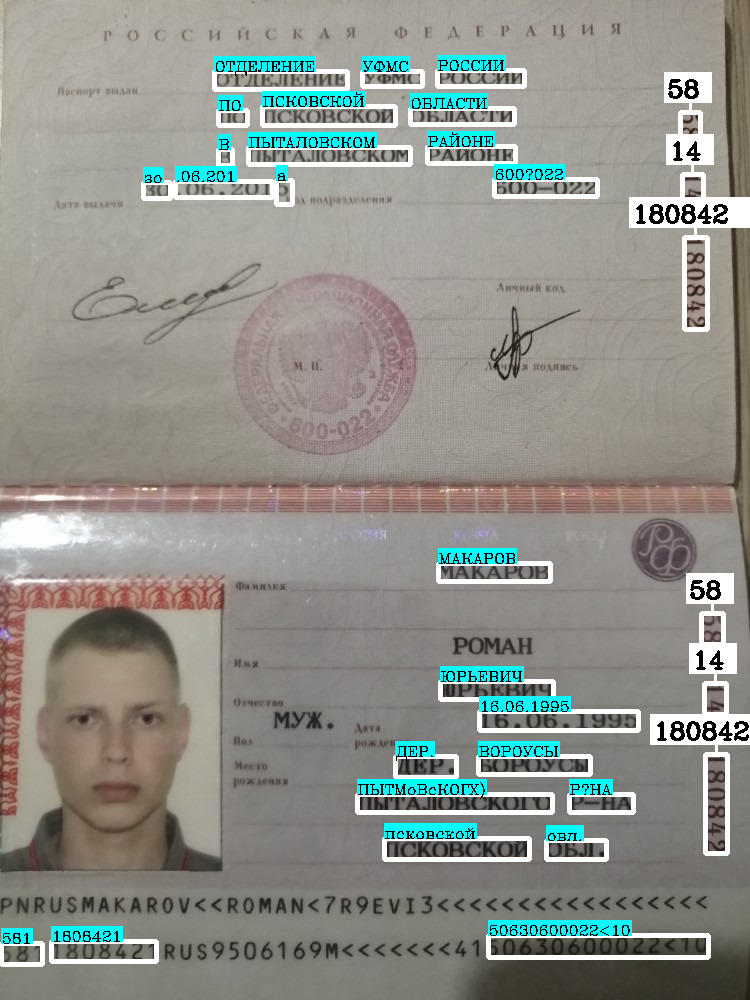

[351, 137, 340, 181]
[351, 137, 340, 181]
[351, 137, 340, 181]
[351, 137, 340, 181]


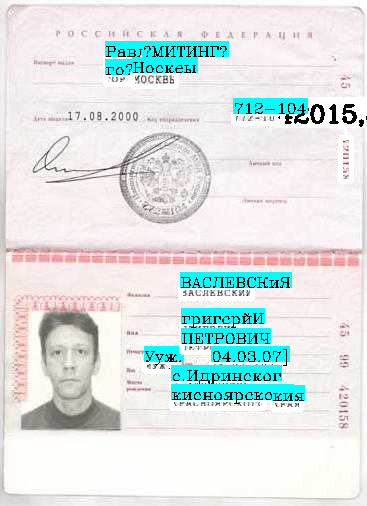

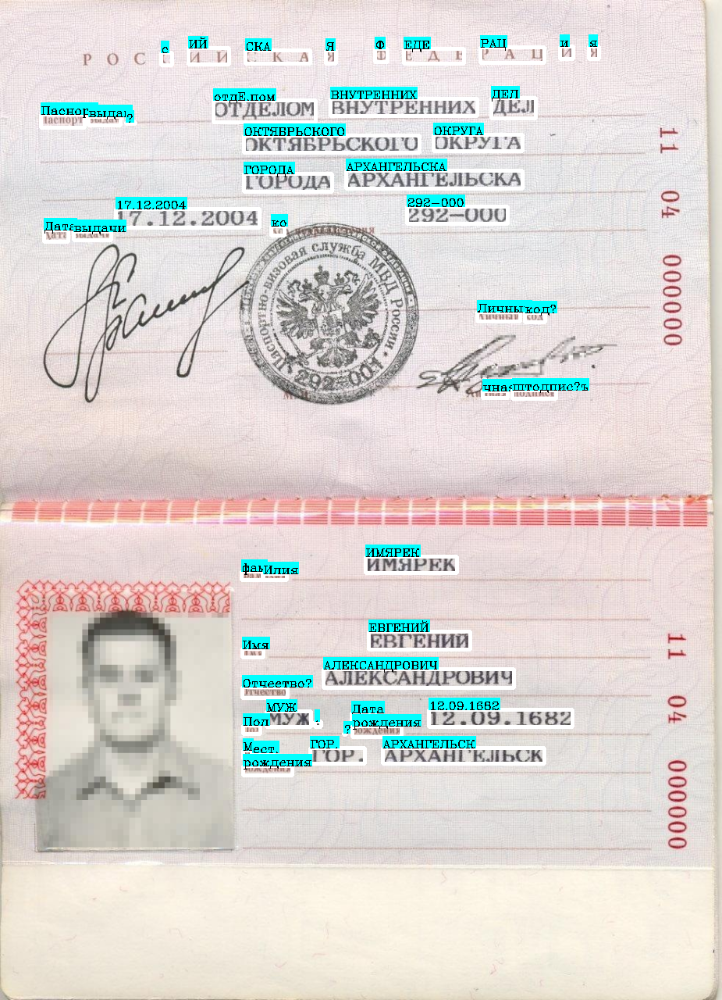

[955, 103, 949, 118]
[955, 103, 949, 118]
[955, 103, 949, 118]
[955, 103, 949, 118]
[905, 75, 897, 103]
[905, 75, 897, 103]
[905, 75, 897, 103]
[905, 75, 897, 103]
[905, 106, 897, 133]
[905, 106, 897, 133]
[905, 106, 897, 133]
[905, 106, 897, 133]
[905, 136, 897, 147]
[905, 136, 897, 147]
[905, 136, 897, 147]
[905, 136, 897, 147]


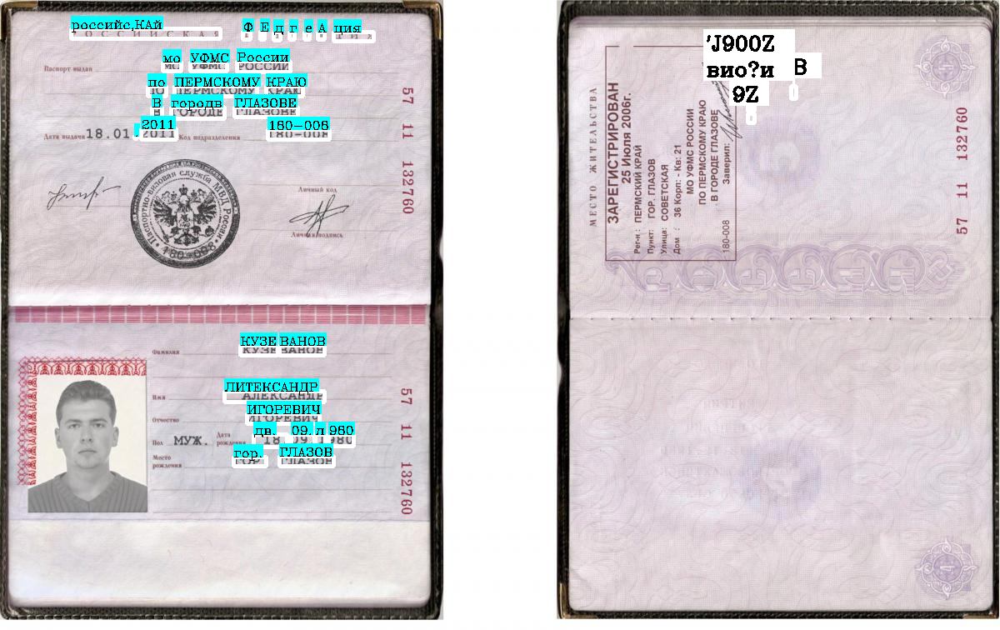

[696, 286, 677, 312]
[696, 286, 677, 312]
[696, 286, 677, 312]
[696, 286, 677, 312]
[698, 348, 679, 373]
[698, 348, 679, 373]
[698, 348, 679, 373]
[698, 348, 679, 373]
[699, 409, 679, 498]
[699, 409, 679, 498]
[699, 409, 679, 498]
[699, 409, 679, 498]
[690, 745, 671, 771]
[690, 745, 671, 771]
[690, 745, 671, 771]
[690, 745, 671, 771]
[694, 806, 675, 831]
[694, 806, 675, 831]
[694, 806, 675, 831]
[694, 806, 675, 831]
[701, 866, 678, 954]
[701, 866, 678, 954]
[701, 866, 678, 954]
[701, 866, 678, 954]


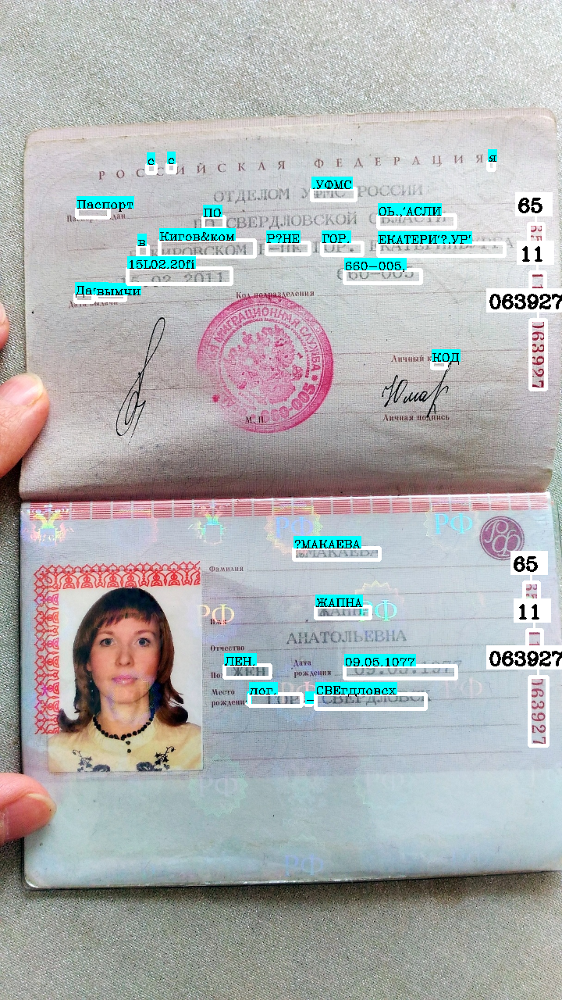

In [ ]:
for key, value in img_url_n_path.items():
  img_api = cv2.imread('/content/drive/My Drive/DataForOCR/'+key)
  shape = img_api.shape[0]
  bboxes, labels = ocr_api(value[0], img_api)
  bboxes_r, labels_r = ocr_api(value[1], img_api)
  if shape > 1280:
    img_api = cv2.resize(img_api, (0, 0), fx=1280/shape, fy=1280/shape)
  for j in range(len(bboxes_r)):
    if (bboxes_r[j][1]) > (img_api.shape[1])-((img_api.shape[1]*3)//4):
      continue
    bboxes_r[j][0],bboxes_r[j][1],bboxes_r[j][2],bboxes_r[j][3] = img_api.shape[1] - bboxes_r[j][1],bboxes_r[j][0],img_api.shape[1] - bboxes_r[j][3],bboxes_r[j][2]
    rect_n_label(img_api, bboxes_r[j],labels_r[j],t_shape=True)
  rect_n_label(img_api, bboxes,labels,t_shape=False)
  cv2_imshow(img_api)
  cv2.imwrite(f'api_ocr_{key[0]}_v2.jpeg', img_api)

Также при использовании данного API наблюдал проблему, что если изображение слишком большое, то внутри API оно его downscale'ит и выдает bbox в том формате, что привело к съезжанию рамок. Решил путем подбора, идеальная размерность в которой приводить пришласть на 1280